# Cleaning

In [32]:
import pandas as pd
import numpy as np

import missingno as msno
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split 
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.decomposition import TruncatedSVD

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
import datetime
from dateutil.parser import parse
from sklearn.tree import  DecisionTreeClassifier
import plotly.graph_objects as go
import umap
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
import xgboost as xgb
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import GridSearchCV
import ml_metrics
import seaborn as sns
import warnings
from plotly.subplots import make_subplots
from sklearn.metrics import accuracy_score
import plotly.graph_objects as go
warnings.filterwarnings("ignore")



In [2]:
Data=pd.read_csv("consolidation_01June2022.csv").drop(columns=["Unnamed: 0"]).fillna("")
Data.head()

,pref_B-B,pref_D-E,pref_C-D,pref_A-A,Duracion_Campaña,B,C,lec_B-B,lec_E-E,lec_D-E,...,Renta,Recibe_sueldo_en_cuenta,Segmento_consumidor,Meses_antiguedad,Comuna,Ciudad,Estado_civil,Principalidad,Profesion,Target
0,0.0,0.0,0.0,0.0,1.0,4.0,5.0,5.0,0.0,0.0,...,R1,0,A,Mayor a 10 años,331.0,13.0,D,B,P164,
1,0.0,0.0,0.0,0.0,1.0,2.0,9.0,14.0,1.0,1.0,...,R9,0,B,Mayor a 10 años,37.0,5.0,D,E,P164,D-E C-D E-E B-B
2,0.0,0.0,0.0,0.0,1.0,2.0,2.0,5.0,0.0,0.0,...,R9,1,B,Mayor a 10 años,19.0,4.0,B,D,P114,E-E A-A B-B
3,0.0,0.0,0.0,0.0,1.0,2.0,5.0,4.0,0.0,0.0,...,R10,0,B,Mayor a 10 años,37.0,5.0,B,C,P164,B-B E-E D-E A-A
4,0.0,0.0,0.0,0.0,1.0,6.0,6.0,8.0,0.0,1.0,...,R4,0,A,Mayor a 10 años,91.0,13.0,D,B,P85,E-E B-B D-E


<AxesSubplot:>

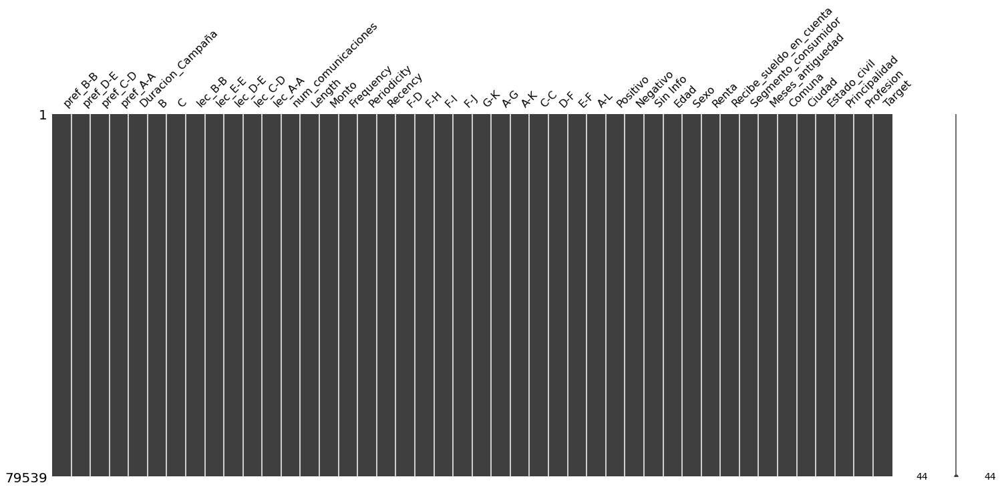

In [3]:
# Missings
msno.matrix(Data)

In [4]:
# datos númericos
numerical=list(Data.select_dtypes(exclude=["category","object"]).columns)
numerical.remove("Sexo")
numerical.remove('Recibe_sueldo_en_cuenta')


# datos categorical
categorical=list(Data.select_dtypes(include=["category","object"]).columns)+['Sexo','Recibe_sueldo_en_cuenta']
categorical

['Edad',
 'Renta',
 'Segmento_consumidor',
 'Meses_antiguedad',
 'Comuna',
 'Ciudad',
 'Estado_civil',
 'Principalidad',
 'Profesion',
 'Target',
 'Sexo',
 'Recibe_sueldo_en_cuenta']

# Clean Target

**Criterio de selección de variables para mejorar la velocidad de la grilla que optimizara MAP**

In [5]:
# Replace valores categoricos por númericos
for i in categorical:
    dic={}
    k=0
    for j in Data[i].unique():
        k=k+1
        dic[j]=k
    Data[i].replace(dic,inplace=True)

In [6]:
# Features - labels

features = Data.drop(columns=["Target"]).copy() 
labels = Data.loc[:,"Target"].copy()

# Generación de conjuntos de train y test
X_train, X_test, y_train, y_test = train_test_split(
    features, labels, test_size=0.33,random_state=50)


In [7]:
# Columns transformer
preprocessing_transformer = ColumnTransformer(
    transformers=[
        ('MinMaxScaler',MinMaxScaler(),
         features.columns),
    ])

pipe = Pipeline(
    [("preprocesamiento", preprocessing_transformer)]
)

In [8]:
# Entrenamiento de pípeline
X_train=pd.DataFrame(pipe.fit_transform(X_train),columns=features.columns)

In [9]:
# Según el aporte de información con el criterio gini de un arbol de decisión
fs = DecisionTreeClassifier(criterion='gini', max_depth=10, random_state=1)
fs.fit(X_train, y_train.astype(int))

DecisionTreeClassifier(max_depth=10, random_state=1)

In [10]:
var_num = 30
table = pd.DataFrame({'Tags': features.columns, 'Value': fs.feature_importances_})
table['Abs_Value'] = table['Value'].abs()
table = table[table['Abs_Value']>0].sort_values(by='Abs_Value', ascending=False, ignore_index=True)
tree_fs = table.loc[:var_num, 'Tags'].to_list()

In [11]:
# Plot
fig = go.Figure([go.Bar(x=table["Tags"], y=table["Abs_Value"])])

fig.update_layout(
    title_text="Importancia de variables",
)

fig.show()

In [12]:
# Según selección de variables bajo el criterio Gini
tags2=['E-F',
 'C-C',
 'D-F',
 'A-K',
 'num_comunicaciones',
 'Length',
 'pref_A-A',
 'Positivo',
 'Recency',
 'A-G',
 'Monto',
 'Periodicity',
 'Frequency',
 'lec_B-B',
 'G-K']
numerical2=list(filter(lambda x:x  in numerical,tags2))
categorical2=list(filter(lambda x:x  in categorical,tags2))

**Distribucion inicial Target**

In [19]:
Data=pd.read_csv("consolidation_01June2022.csv").drop(columns=["Unnamed: 0"]).fillna("")

In [20]:
# Visualización
px.histogram(Data, x="Target",title="Distribution Plot Target")

In [21]:
preprocessing_transformer = ColumnTransformer(
    transformers=[('OneHotEncoder', OneHotEncoder(handle_unknown="ignore"), categorical2),
        ('MinMax', MinMaxScaler(),numerical2),
    ])

In [22]:
pipe_naive = Pipeline(
    [
        ("preprocesamiento", preprocessing_transformer), 
     ("clf",MultinomialNB())
    ]
)

In [23]:
pipe_decision_tree = Pipeline(
    [("preprocesamiento", preprocessing_transformer),
     ("clf", DecisionTreeClassifier(random_state=0))]
)


In [24]:
list_map=[]
list_accuracy=[]
num_categorias_target=[]
cut=list(np.arange(0,1000,10))
for i in cut:
    print(i)
    # Generación de conjuntos de train y test
    XYtrain, XYtest = train_test_split(
        Data, test_size=0.33 ) 

    # nombre cols
    XYtrain=pd.DataFrame(XYtrain,columns=Data.columns)
    XYtest=pd.DataFrame(XYtest,columns=Data.columns)

    # Sep target test
    Xtest=XYtest.drop(columns=["Target"]).copy()
    Ytest=XYtest["Target"].copy()

    # Dejamos target con una cantidad mayor a x
    targets_creibles=list(XYtrain["Target"].value_counts()[XYtrain["Target"].value_counts()>i].index)

    # Append categorias
    num_categorias_target.append(len(targets_creibles))###############

    # filtro
    XYtrain=XYtrain[XYtrain["Target"].isin(targets_creibles)]

    
    # Sep target train
    Xtrain=XYtrain.drop(columns=["Target"]).copy()
    Ytrain=XYtrain["Target"].copy()

    
    # ROS
    ros=RandomOverSampler(random_state=0)
    
    # ROS:
    Xtrain, Ytrain=ros.fit_resample(Xtrain,Ytrain)

    # FIT:
    # Train
    pipe_decision_tree.fit(Xtrain, Ytrain)

    # Pred
    Ypred = pipe_decision_tree.predict(Xtest)
    
    # Accuracy
    list_accuracy.append(accuracy_score(Ypred, Ytest))##################
    #MAP
    Ypred_map=pd.Series(Ypred).apply( lambda x: x.split(" "))
    Ytest_map=pd.Series(Ytest).apply( lambda x: x.split(" "))
    list_map.append(ml_metrics.mapk(Ytest_map, Ypred_map, 5))#######################

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990


In [27]:
# Visualización

fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=("Métrica MAP", "Métrica Accuracy","Valores únicos target"))
# Create traces

fig.add_trace(go.Scatter(x=cut, y=list_map,
                    mode='lines',
                    name='MAP'),row=1, col=1)
fig.add_trace(go.Scatter(x=cut, y=list_accuracy,
                    mode='lines',
                    name='Accuracy'),row=2, col=1)
fig.add_trace(go.Scatter(x=cut, y=num_categorias_target,
                    mode='lines', name='# Categorias'),row=3, col=1)

fig.update_layout(title_text="Optimización MAP",
                      height=800,
                      width=1000,font=dict(color="white"),template="plotly_dark",legend_tracegroupgap = 90,legend_title="Leyenda")

fig.update_xaxes(title_text="Criterio de Corte",row=3, col=1)
fig.update_yaxes(title_text="MAP", row=1, col=1)
fig.update_yaxes(title_text="Accuracy", row=2, col=1)
fig.update_yaxes(title_text="# Categorias", row=3, col=1)
fig.add_vrect(x0=110, x1=110,opacity=0.25,fillcolor="#0EB9B9")
fig.show()

#### Bajo este criterio, se eliminan las categorias que no contrinuyen a maximizar el MAP.


In [28]:
# Dejamos target con una cantidad mayor a 500
targets_creibles=list(Data["Target"].value_counts()[Data["Target"].value_counts()>110].index)
len(targets_creibles)

74

In [29]:
Data=Data[Data["Target"].isin(targets_creibles)]
Data.head()

,pref_B-B,pref_D-E,pref_C-D,pref_A-A,Duracion_Campaña,B,C,lec_B-B,lec_E-E,lec_D-E,...,Renta,Recibe_sueldo_en_cuenta,Segmento_consumidor,Meses_antiguedad,Comuna,Ciudad,Estado_civil,Principalidad,Profesion,Target
0,0.0,0.0,0.0,0.0,1.0,4.0,5.0,5.0,0.0,0.0,...,R1,0,A,Mayor a 10 años,331.0,13.0,D,B,P164,
1,0.0,0.0,0.0,0.0,1.0,2.0,9.0,14.0,1.0,1.0,...,R9,0,B,Mayor a 10 años,37.0,5.0,D,E,P164,D-E C-D E-E B-B
2,0.0,0.0,0.0,0.0,1.0,2.0,2.0,5.0,0.0,0.0,...,R9,1,B,Mayor a 10 años,19.0,4.0,B,D,P114,E-E A-A B-B
4,0.0,0.0,0.0,0.0,1.0,6.0,6.0,8.0,0.0,1.0,...,R4,0,A,Mayor a 10 años,91.0,13.0,D,B,P85,E-E B-B D-E
6,0.0,0.0,0.0,0.0,1.0,2.0,3.0,1.0,0.0,0.0,...,R5,0,A,Mayor a 10 años,34.0,5.0,B,C,P143,D-E A-A


In [30]:
# Visualización
px.histogram(Data, x="Target",title="Distribution Plot Target")

In [31]:
Data.shape

(73901, 44)

# Outliers

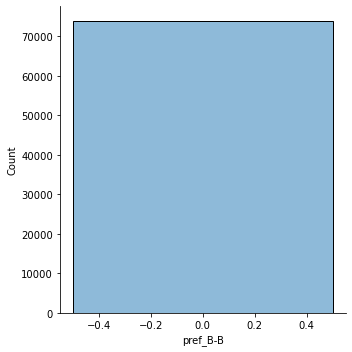

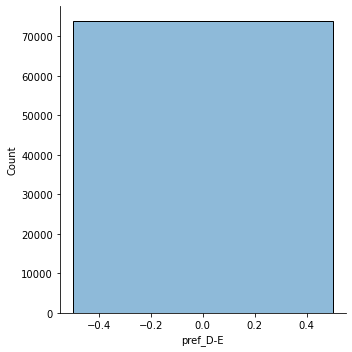

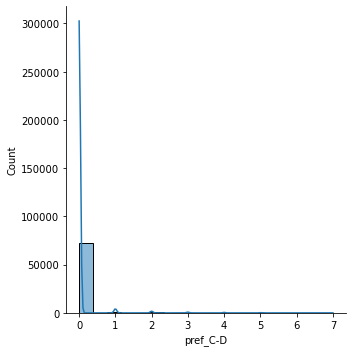

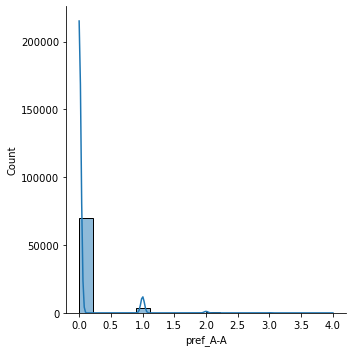

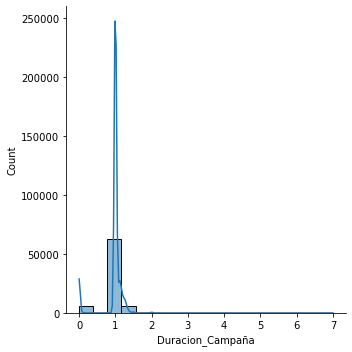

...

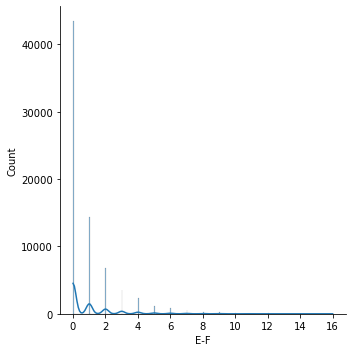

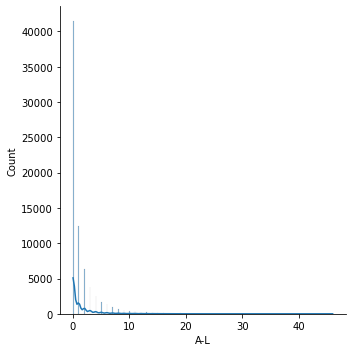

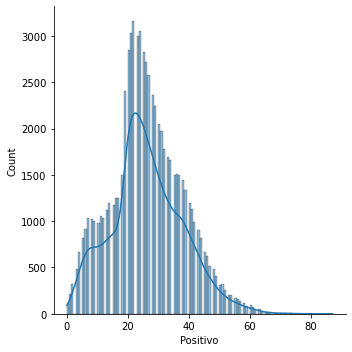

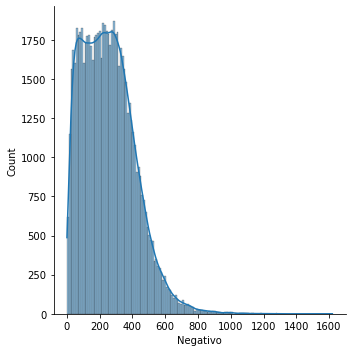

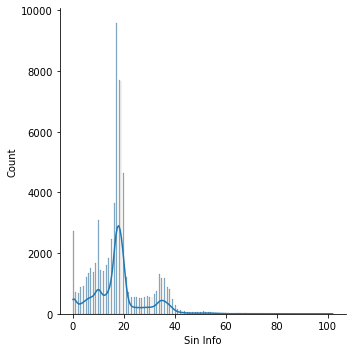

In [39]:
# Numeric
for i in numerical:
    sns.displot(Data, x=i, kde=True)
    plt.show()

In [41]:
# Categorical
for i in categorical:
    Data[i]=Data[i].astype(str)

In [42]:
# Categorical
for i in categorical:
    fig = px.histogram(Data, x=i, marginal="box",title="Distribution Plot "+i,height=800,
                      width=1000)
    fig.show()

#### De momento se mantiene la distribución original de los datos.

In [43]:
# Se guarda raw en csv
Data.to_csv('cleaned_'+pd.to_datetime('today').strftime('%d%B%Y')+'.csv', index=True)